In [24]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import plotly.express as px
from IPython.display import display, HTML
import warnings
from colorama import Fore, Style

from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler, QuantileTransformer, OneHotEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split, RandomizedSearchCV, GridSearchCV
from sklearn.metrics import accuracy_score, classification_report, precision_score, recall_score, f1_score, roc_auc_score
from scipy.stats import randint
from sklearn.preprocessing import LabelEncoder

warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings('ignore')

In [25]:
df_tr = pd.read_csv('/Users/mdfahimulkabirchowdhury/Github-Fahimul/Credit Card Fraud Detection/data/raw/creditcard_2023.csv')

In [26]:
from IPython.display import display, HTML

def print_dataset_analysis(train_dataset, n_top=5):
    # Displaying the first few rows of the dataset
    display(HTML("<h3>Basic Overview of Data:</h3>"))
    display(train_dataset.head(n_top))

    # Displaying the summary statistics of the dataset
    display(HTML("<h3>Data Summary:</h3>"))
    display(train_dataset.describe())

    # Checking for null values
    display(HTML("<h3>Null Values in Data:</h3>"))
    train_null_count = train_dataset.isnull().sum()
    if train_null_count.sum() == 0:
        display(HTML("<p>No null values in the dataset.</p>"))
    else:
        display(HTML("<p>Null values found in the following columns:</p>"))
        display(train_null_count[train_null_count > 0].to_frame())

    # Checking for duplicate rows
    train_duplicates = train_dataset.duplicated().sum()
    display(HTML("<h3>Duplicate Values in Data:</h3>"))
    display(HTML(f"<p>{train_duplicates} duplicate rows found.</p>"))

    # Displaying the shape of the dataset
    display(HTML("<h3>Data Shape:</h3>"))
    display(HTML(f"<p>Rows: {train_dataset.shape[0]}, Columns: {train_dataset.shape[1]}</p>"))

def print_unique_values(train_dataset):
    # Displaying unique values in each column
    display(HTML("<h3>Unique Values in Data:</h3>"))
    unique_values_table = pd.DataFrame({
        'Column Name': train_dataset.columns,
        'Data Type': [train_dataset[col].dtype for col in train_dataset.columns],
        'Unique Values': [', '.join(map(str, train_dataset[col].unique()[:7])) for col in train_dataset.columns]
    })
    display(unique_values_table)

# Example usage with `df_tr`
print_dataset_analysis(df_tr, n_top=5)
print_unique_values(df_tr)


,id,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0,-0.260648,-0.469648,2.496266,-0.083724,0.129681,0.732898,0.519014,-0.130006,0.727159,...,-0.110552,0.217606,-0.134794,0.165959,0.126280,-0.434824,-0.081230,-0.151045,17982.10,0
1,1,0.985100,-0.356045,0.558056,-0.429654,0.277140,0.428605,0.406466,-0.133118,0.347452,...,-0.194936,-0.605761,0.079469,-0.577395,0.190090,0.296503,-0.248052,-0.064512,6531.37,0
2,2,-0.260272,-0.949385,1.728538,-0.457986,0.074062,1.419481,0.743511,-0.095576,-0.261297,...,-0.005020,0.702906,0.945045,-1.154666,-0.605564,-0.312895,-0.300258,-0.244718,2513.54,0
3,3,-0.152152,-0.508959,1.746840,-1.090178,0.249486,1.143312,0.518269,-0.065130,-0.205698,...,-0.146927,-0.038212,-0.214048,-1.893131,1.003963,-0.515950,-0.165316,0.048424,5384.44,0
4,4,-0.206820,-0.165280,1.527053,-0.448293,0.106125,0.530549,0.658849,-0.212660,1.049921,...,-0.106984,0.729727,-0.161666,0.312561,-0.414116,1.071126,0.023712,0.419117,14278.97,0


,id,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,568630.000000,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,...,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,568630.000000,568630.0
mean,284314.500000,-5.638058e-17,-1.323544e-16,-3.518788e-17,-2.879008e-17,7.197521e-18,-3.838678e-17,-3.198898e-17,2.069287e-17,9.116859e-17,...,4.758361e-17,5.398140e-18,5.395017e-18,-1.999311e-18,-3.028957e-17,-7.547400e-18,-3.598760e-17,2.499139e-17,12041.957635,0.5
std,164149.486122,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,...,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,6919.644449,0.5
min,0.000000,-3.495584e+00,-4.996657e+01,-3.183760e+00,-4.951222e+00,-9.952786e+00,-2.111111e+01,-4.351839e+00,-1.075634e+01,-3.751919e+00,...,-1.938252e+01,-7.734798e+00,-3.029545e+01,-4.067968e+00,-1.361263e+01,-8.226969e+00,-1.049863e+01,-3.903524e+01,50.010000,0.0
25%,142157.250000,-5.652859e-01,-4.866777e-01,-6.492987e-01,-6.560203e-01,-2.934955e-01,-4.458712e-01,-2.835329e-01,-1.922572e-01,-5.687446e-01,...,-1.664408e-01,-4.904892e-01,-2.376289e-01,-6.515801e-01,-5.541485e-01,-6.318948e-01,-3.049607e-01,-2.318783e-01,6054.892500,0.0
50%,284314.500000,-9.363846e-02,-1.358939e-01,3.528579e-04,-7.376152e-02,8.108788e-02,7.871758e-02,2.333659e-01,-1.145242e-01,9.252647e-02,...,-3.743065e-02,-2.732881e-02,-5.968903e-02,1.590123e-02,-8.193162e-03,-1.189208e-02,-1.729111e-01,-1.392973e-02,12030.150000,0.5
75%,426471.750000,8.326582e-01,3.435552e-01,6.285380e-01,7.070047e-01,4.397368e-01,4.977881e-01,5.259548e-01,4.729905e-02,5.592621e-01,...,1.479787e-01,4.638817e-01,1.557153e-01,7.007374e-01,5.500147e-01,6.728879e-01,3.340230e-01,4.095903e-01,18036.330000,1.0
max,568629.000000,2.229046e+00,4.361865e+00,1.412583e+01,3.201536e+00,4.271689e+01,2.616840e+01,2.178730e+02,5.958040e+00,2.027006e+01,...,8.087080e+00,1.263251e+01,3.170763e+01,1.296564e+01,1.462151e+01,5.623285e+00,1.132311e+02,7.725594e+01,24039.930000,1.0


,Column Name,Data Type,Unique Values
0,id,int64,"0, 1, 2, 3, 4, 5, 6"
1,V1,float64,"-0.2606478048943981, 0.9850997342386376, -0.26..."
2,V2,float64,"-0.4696484500536342, -0.3560450929163436, -0.9..."
3,V3,float64,"2.4962660826315637, 0.5580563509382045, 1.7285..."
4,V4,float64,"-0.0837239126781463, -0.4296539034065106, -0.4..."
5,V5,float64,"0.1296812361545678, 0.2771402629466986, 0.0740..."
6,V6,float64,"0.7328982498449426, 0.4286045153379263, 1.4194..."
7,V7,float64,"0.5190136179018007, 0.4064660422512956, 0.7435..."
8,V8,float64,"-0.1300060475886773, -0.1331182741764908, -0.0..."
9,V9,float64,"0.7271592691096374, 0.3474518951767279, -0.261..."


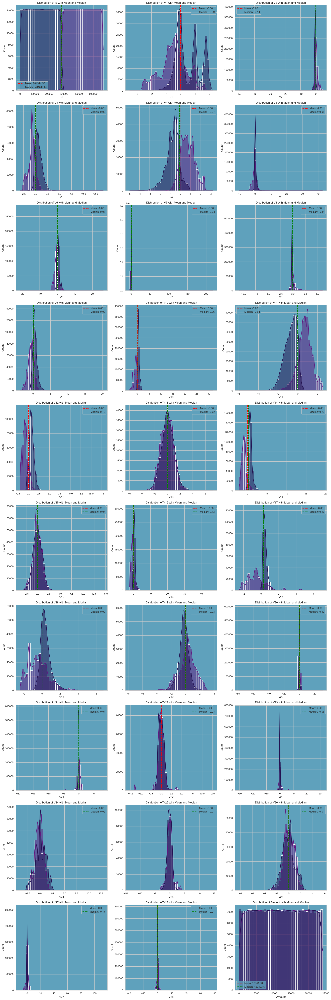

In [27]:
def create_subplots(df, columns, hue, theme_style, theme_rc, palette, figsize=(15, 10)):
    sns.set_theme(style=theme_style, rc=theme_rc)
    
    num_columns = len(columns) - 1  # Exclude the hue column itself
    num_rows = (num_columns + 2) // 3  # Adjust the number of rows based on the number of columns

    fig, axes = plt.subplots(num_rows, 3, figsize=figsize)
    axes = axes.flatten()
    
    plot_index = 0
    for col in columns:
        if col == hue:  # Skip the hue column itself
            continue

        sns.histplot(data=df, x=col, hue=hue, bins=40, palette=palette, edgecolor='white', kde=True, ax=axes[plot_index])
        
        mean_value = df[col].mean()
        median_value = df[col].median()
        
        axes[plot_index].axvline(mean_value, color='red', linestyle='dashed', linewidth=2, label=f'Mean: {mean_value:.2f}')
        axes[plot_index].axvline(median_value, color='green', linestyle='dashed', linewidth=2, label=f'Median: {median_value:.2f}')
        
        axes[plot_index].set_title(f'Distribution of {col} with Mean and Median')
        axes[plot_index].set_xlabel(col)
        axes[plot_index].set_ylabel('Count')
        axes[plot_index].legend()
        
        plot_index += 1
    
    # Remove extra axes
    for j in range(plot_index, len(axes)):
        fig.delaxes(axes[j])
    
    plt.tight_layout()
    plt.show()

# Example usage
columns = df_tr.columns.to_list()  
palette = sns.color_palette("magma")  # Use the color palette list instead of cmap

create_subplots(df=df_tr, columns=columns, hue='Class', 
                theme_style='whitegrid', theme_rc={"axes.facecolor": "#5fa1bc"}, 
                palette=palette, figsize=(20, 60))


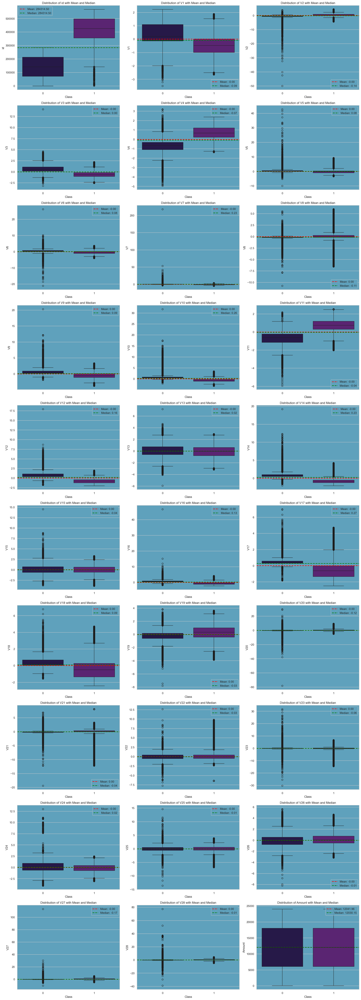

In [28]:
def create_boxplot_subplots(df, columns, hue, theme_style, theme_rc, palette, figsize=(15, 10)):
    sns.set_theme(style=theme_style, rc=theme_rc)
    
    num_columns = len(columns)
    num_rows = (num_columns + 2) // 3  # Adjust the number of rows based on the number of columns

    fig, axes = plt.subplots(num_rows, 3, figsize=figsize)
    axes = axes.flatten()
    
    plot_index = 0
    for col in columns:
        if col == hue:  # Skip the hue column itself
            continue

        sns.boxplot(data=df, x=hue, y=col, palette=palette, ax=axes[plot_index])
        
        mean_value = df[col].mean()
        median_value = df[col].median()
        
        axes[plot_index].axhline(mean_value, color='red', linestyle='dashed', linewidth=2, label=f'Mean: {mean_value:.2f}')
        axes[plot_index].axhline(median_value, color='green', linestyle='dashed', linewidth=2, label=f'Median: {median_value:.2f}')
        
        axes[plot_index].set_title(f'Distribution of {col} with Mean and Median')
        axes[plot_index].set_xlabel(hue)
        axes[plot_index].set_ylabel(col)
        axes[plot_index].legend()
        
        plot_index += 1
    
    # Remove extra axes
    for j in range(plot_index, len(axes)):
        fig.delaxes(axes[j])
    
    plt.tight_layout()
    plt.show()

# Example usage
columns = df_tr.columns.to_list() 
palette = sns.color_palette("magma")  # Use the color palette list instead of cmap

create_boxplot_subplots(df=df_tr, columns=columns, hue='Class', 
                        theme_style='whitegrid', theme_rc={"axes.facecolor": "#5fa1bc"}, 
                        palette=palette, figsize=(20, 60))


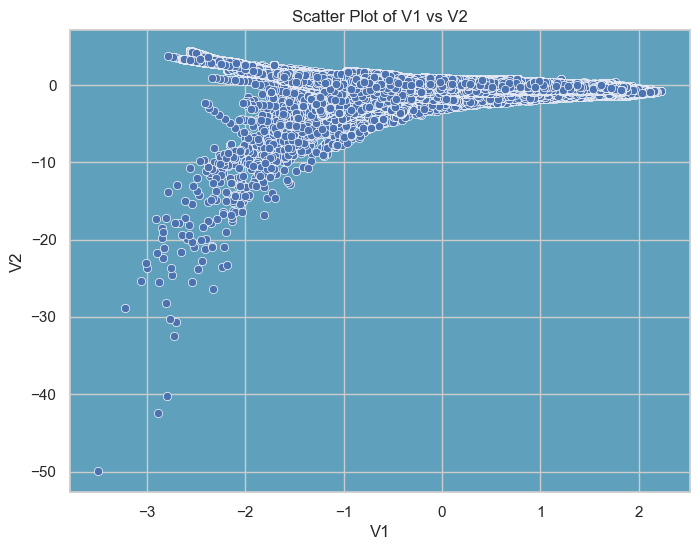

In [29]:
import matplotlib.pyplot as plt
import seaborn as sns

def scatter_plot(df, x_col, y_col):
    plt.figure(figsize=(8, 6))
    sns.scatterplot(data=df, x=x_col, y=y_col)
    plt.title(f'Scatter Plot of {x_col} vs {y_col}')
    plt.show()

# Example usage
scatter_plot(df_tr, 'V1', 'V2')  # Replace 'V1' and 'V2' with relevant column names


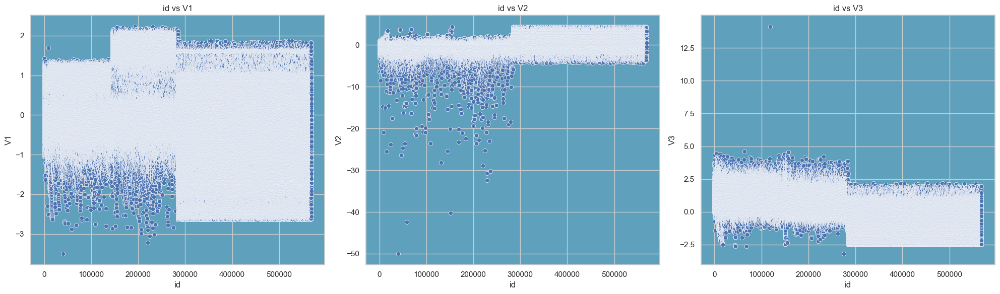

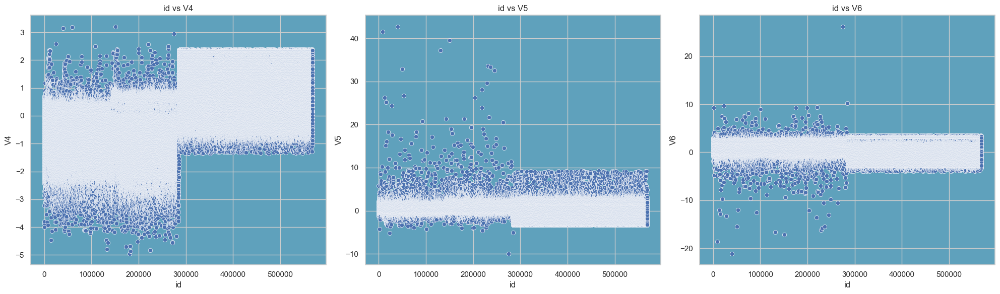

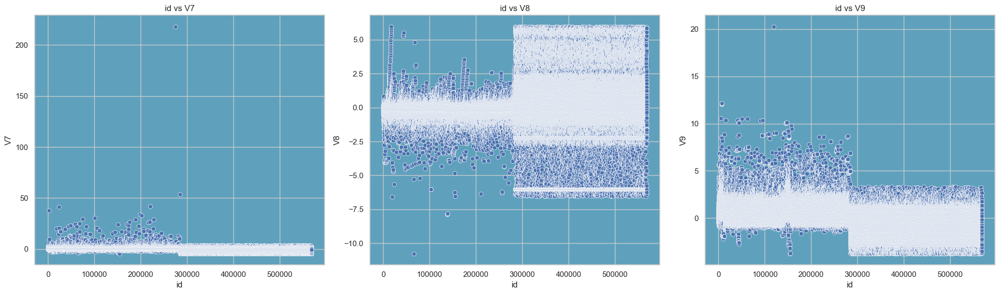

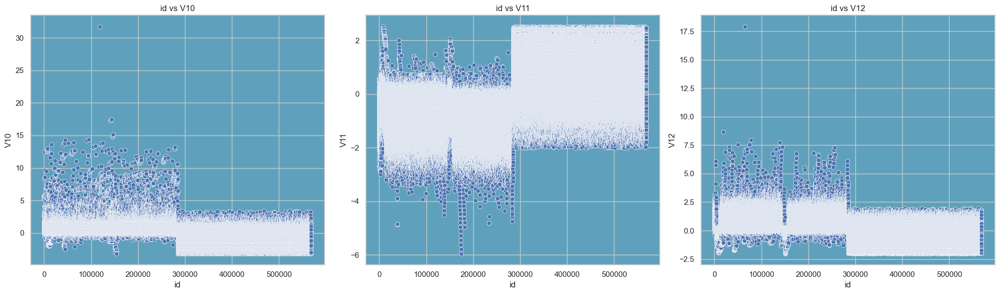

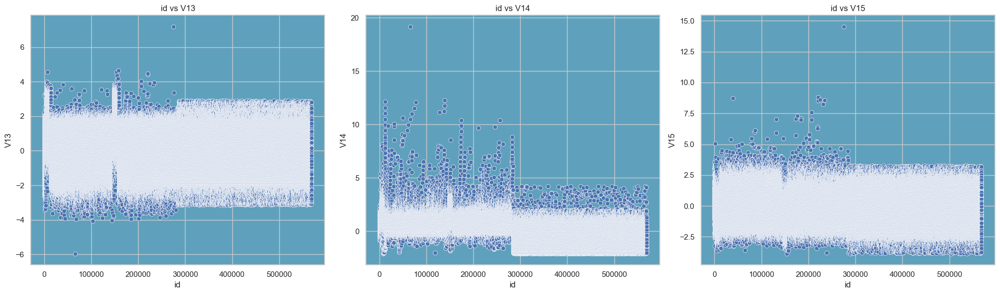

...

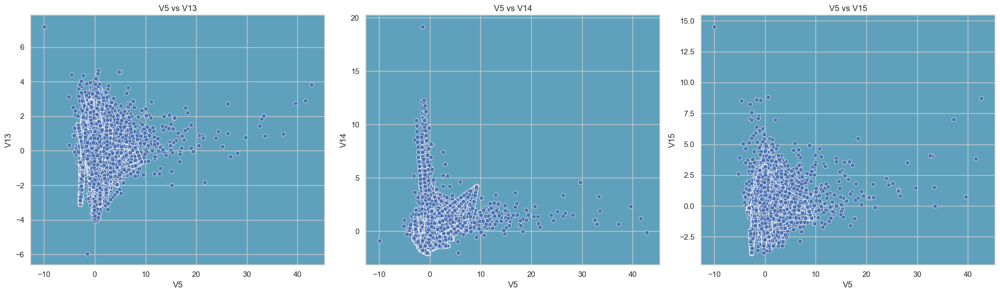

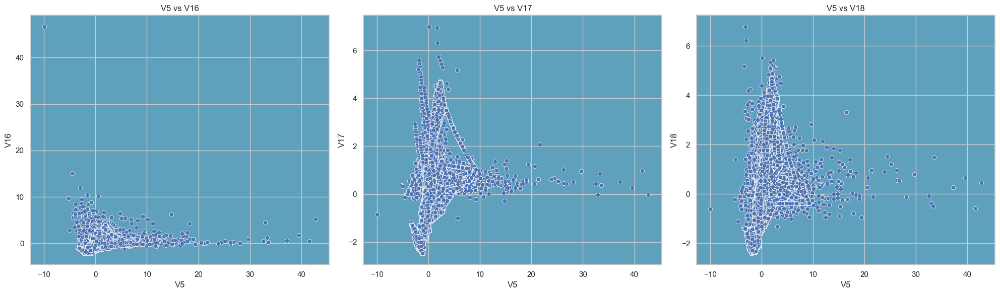

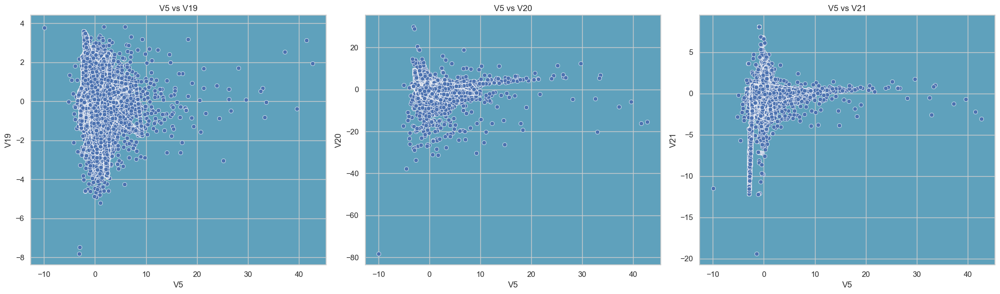

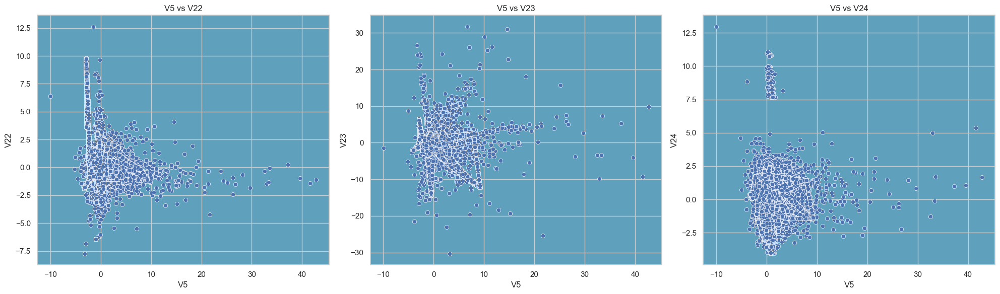

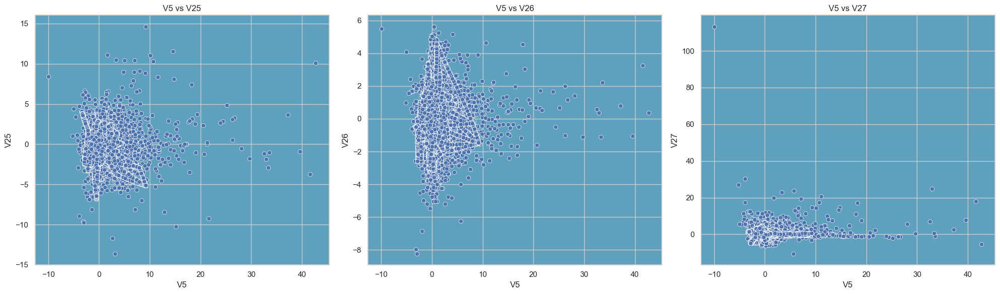

KeyboardInterrupt: 

In [33]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_scatter_all_columns(df, plots_per_row=3):
    # Select only numeric columns
    numeric_columns = df.select_dtypes(include=[np.number]).columns
    num_columns = len(numeric_columns)
    
    # Calculate the number of rows needed for the subplot grid
    num_rows = (num_columns * (num_columns - 1)) // 2  # Number of scatter plots
    total_plots = len(numeric_columns) * (len(numeric_columns) - 1) // 2
    num_rows = (total_plots + plots_per_row - 1) // plots_per_row  # Calculate the number of rows needed
    
    # Initialize plot index
    plot_index = 0
    
    for i in range(len(numeric_columns)):
        for j in range(i + 1, len(numeric_columns)):
            if plot_index % plots_per_row == 0:
                # Create a new figure for each row of plots
                fig, axes = plt.subplots(1, plots_per_row, figsize=(20, 6))

            # Determine which subplot to use in the current figure
            col_index = plot_index % plots_per_row

            # Plot the scatterplot
            sns.scatterplot(x=df[numeric_columns[i]], y=df[numeric_columns[j]], ax=axes[col_index])
            axes[col_index].set_title(f'{numeric_columns[i]} vs {numeric_columns[j]}')

            plot_index += 1

            # If we've filled the row, show the plot and reset the figure
            if plot_index % plots_per_row == 0 or plot_index == total_plots:
                plt.tight_layout()
                plt.show()

    # If there are remaining plots that haven't been shown, display them
    if plot_index % plots_per_row != 0:
        plt.tight_layout()
        plt.show()

# Example usage:
plot_scatter_all_columns(df_tr, plots_per_row=3)


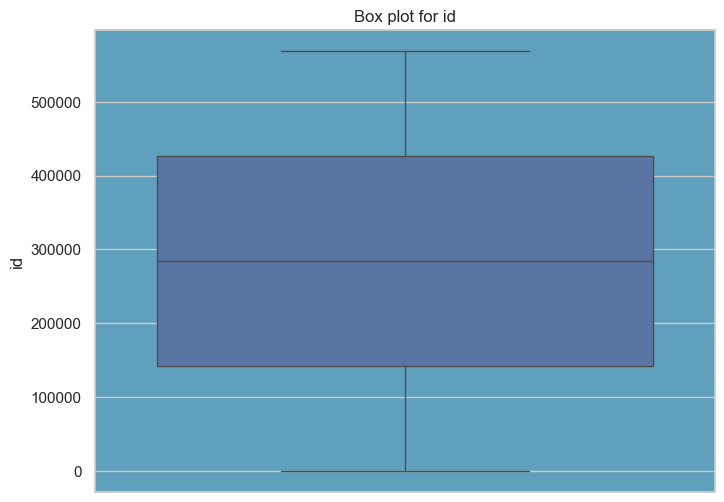

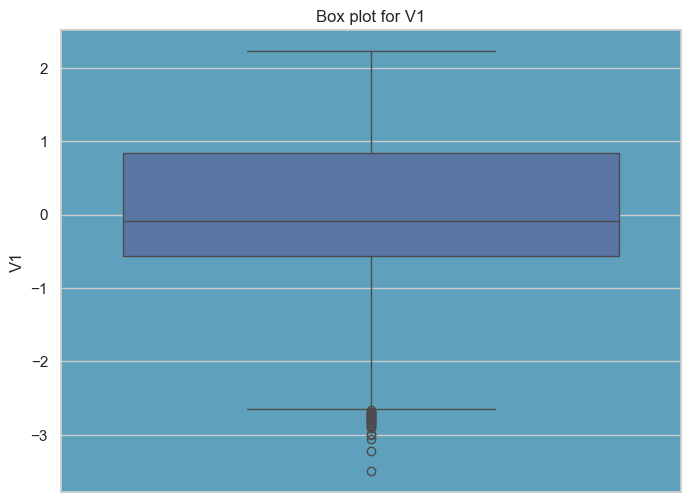

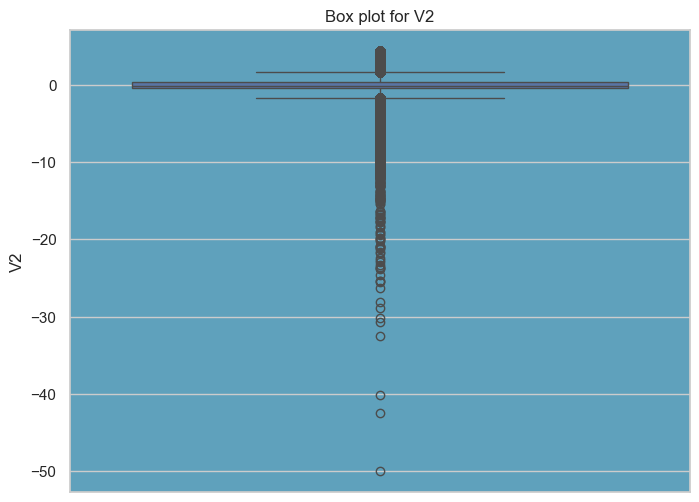

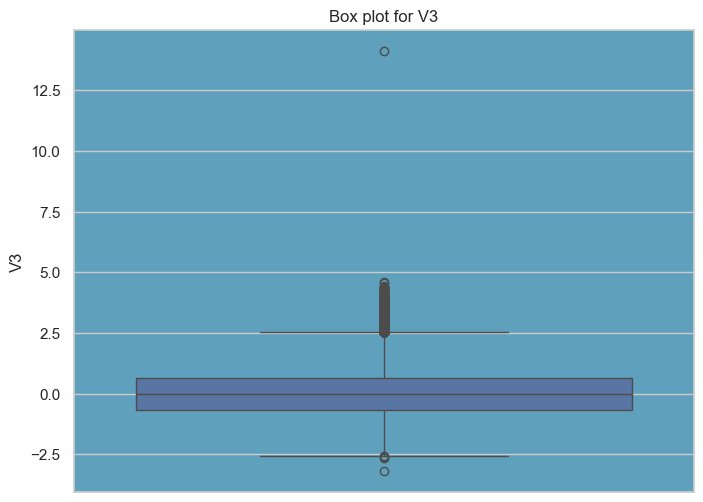

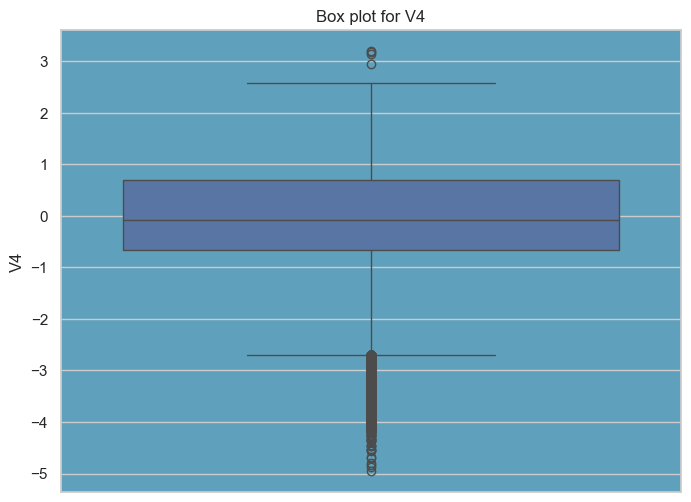

...

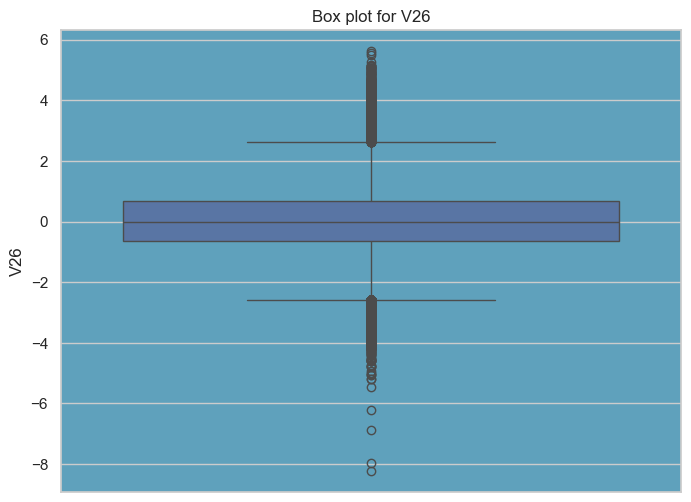

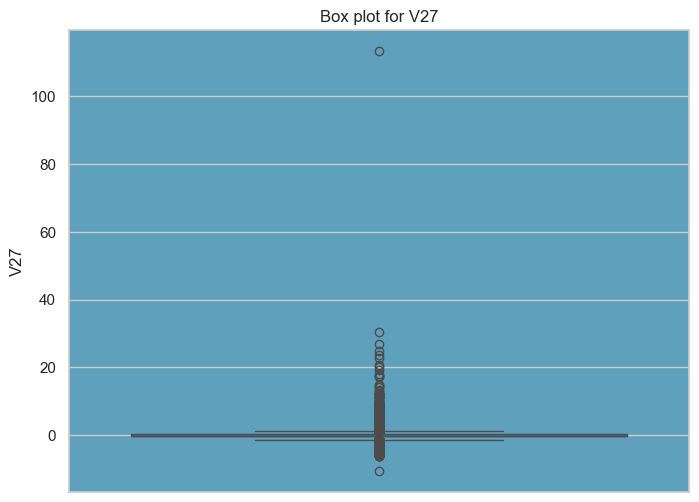

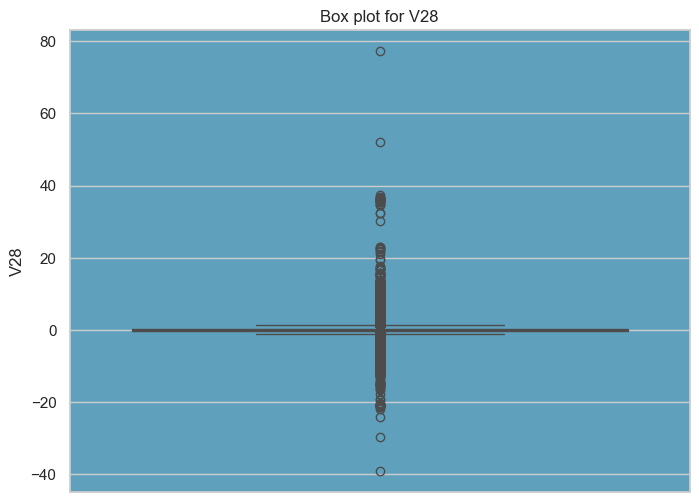

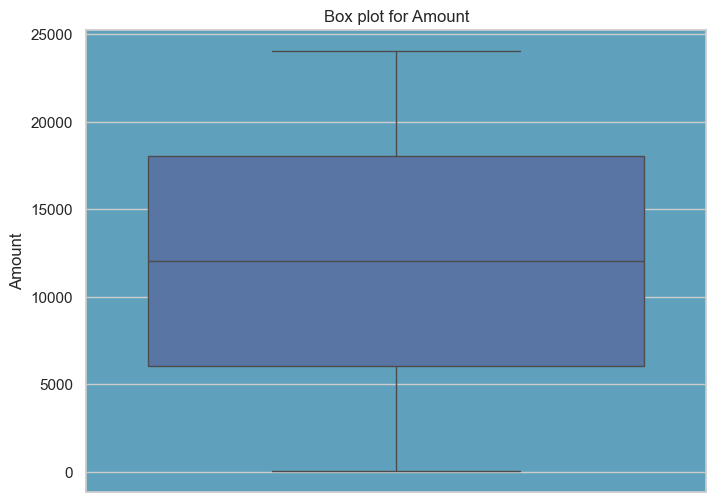

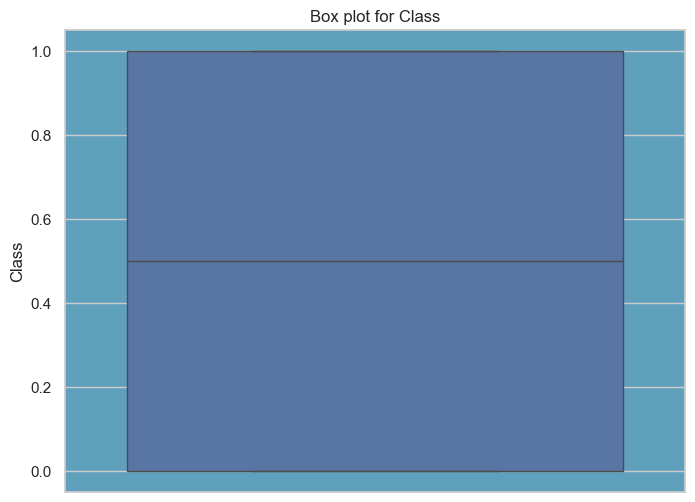

In [43]:
# Individual box plot for each numeric column
def plot_box_all_columns(df):
    numeric_columns = df.select_dtypes(include=[np.number]).columns
    for col in numeric_columns:
        plt.figure(figsize=(8, 6))
        sns.boxplot(data=df[col])
        plt.title(f'Box plot for {col}')
        plt.show()

# Combined box plot for all numeric columns
def plot_combined_box(df):
    plt.figure(figsize=(10, 8))
    sns.boxplot(data=df.select_dtypes(include=[np.number]))
    plt.title("Combined Box Plot for All Numeric Columns")
    plt.xticks(rotation=90)
    plt.show()

# Example usage:
plot_box_all_columns(df_tr)
# plot_combined_box(df_tr)


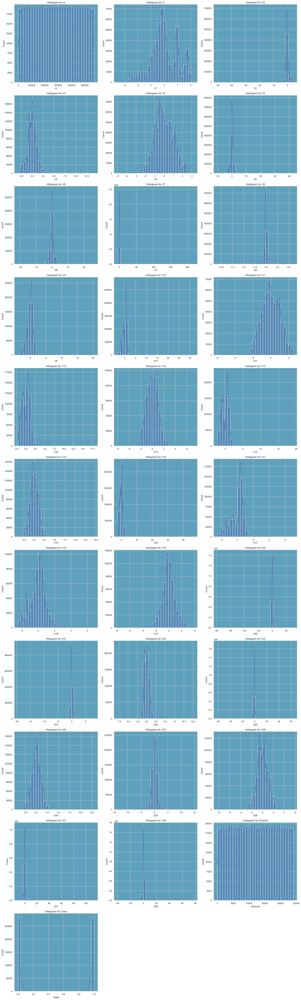

In [36]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_histogram_all_columns(df, plots_per_row=3):
    # Select numeric columns
    numeric_columns = df.select_dtypes(include=[np.number]).columns
    num_columns = len(numeric_columns)
    
    # Calculate the number of rows required
    num_rows = (num_columns + plots_per_row - 1) // plots_per_row

    # Create a figure with subplots
    fig, axes = plt.subplots(num_rows, plots_per_row, figsize=(20, 6 * num_rows))
    axes = axes.flatten()  # Flatten axes array to make indexing easier
    
    # Plot histograms in the grid
    for i, col in enumerate(numeric_columns):
        sns.histplot(df[col], kde=True, bins=30, ax=axes[i])
        axes[i].set_title(f'Histogram for {col}')
    
    # Remove any empty subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])
    
    plt.tight_layout()
    plt.show()

# Example usage:
plot_histogram_all_columns(df_tr, plots_per_row=3)


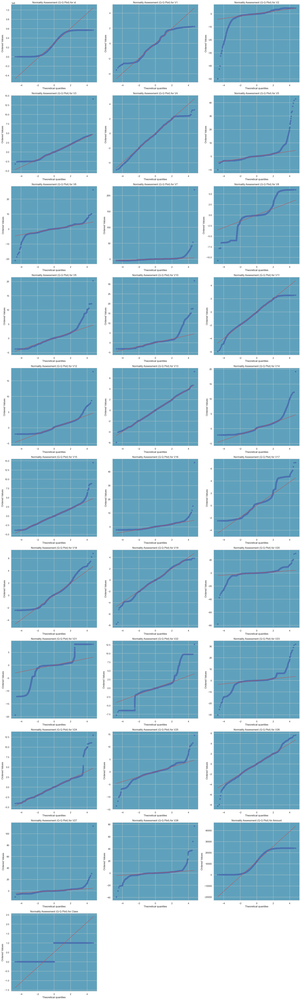

In [38]:
import matplotlib.pyplot as plt
from scipy import stats
import numpy as np

def plot_normality_assessment(df, plots_per_row=3):
    numeric_columns = df.select_dtypes(include=[np.number]).columns
    num_columns = len(numeric_columns)
    
    # Calculate the number of rows required
    num_rows = (num_columns + plots_per_row - 1) // plots_per_row

    # Create a figure with subplots
    fig, axes = plt.subplots(num_rows, plots_per_row, figsize=(20, 6 * num_rows))
    axes = axes.flatten()  # Flatten axes array to make indexing easier
    
    # Plot Q-Q plots in the grid
    for i, col in enumerate(numeric_columns):
        stats.probplot(df[col], dist="norm", plot=axes[i])
        axes[i].set_title(f'Normality Assessment (Q-Q Plot) for {col}')
    
    # Remove any empty subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])
    
    plt.tight_layout()
    plt.show()

# Example usage:
plot_normality_assessment(df_tr, plots_per_row=3)


In [42]:
import pandas as pd
import numpy as np

def calculate_statistics(df):
    stats_summary = {}
    
    # For numeric columns: mean and standard deviation
    numeric_columns = df.select_dtypes(include=[np.number]).columns
    for col in numeric_columns:
        stats_summary[col] = {
            'Mean': df[col].mean(),
            'Standard Deviation': df[col].std(),
        }
    
    # For categorical columns: proportion of unique values
    categorical_columns = df.select_dtypes(include=[object, 'category']).columns
    for col in categorical_columns:
        stats_summary[col] = {
            'Proportion': df[col].value_counts(normalize=True).to_dict()
        }
    
    # Convert to DataFrame and rearrange it horizontally
    stats_df = pd.DataFrame(stats_summary).T
    
    # If you have proportions, separate them out into their own DataFrame
    proportion_df = pd.DataFrame()
    for col in categorical_columns:
        if col in stats_summary:
            prop_data = stats_summary[col]['Proportion']
            prop_df = pd.Series(prop_data, name=col)
            proportion_df = pd.concat([proportion_df, prop_df], axis=1)
    
    # Combine numeric stats with proportions
    final_df = pd.concat([stats_df, proportion_df], axis=1)
    
    return final_df

# Example usage:
stats_df = calculate_statistics(df_tr)
display(stats_df)


,Mean,Standard Deviation
id,2.843145e+05,164149.486122
V1,-5.638058e-17,1.000001
V2,-1.323544e-16,1.000001
V3,-3.518788e-17,1.000001
V4,-2.879008e-17,1.000001
V5,7.197521e-18,1.000001
V6,-3.838678e-17,1.000001
V7,-3.198898e-17,1.000001
V8,2.069287e-17,1.000001
V9,9.116859e-17,1.000001
